#Step 1: GPU 가용성 확인
Google Colab 환경에서 GPU를 사용할 수 있는지 확인한다. GPU는 YOLOv8과 같은 딥 러닝 모델의 학습 프로세스를 상당히 가속화할 수 있다.

In [ ]:
!nvidia-smi

Mon Mar 31 08:31:02 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   59C    P0             28W /   70W |    2248MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

#Step 2: Unzipping Dataset Files(데이터 세트 파일 압축 해제)
이미지와 주석이 포함된 데이터 세트 파일을 압축 해제합니다. 이러한 파일은 일반적으로 공간을 절약하기 위해 압축되며 이제 YOLOv8 모델을 학습하는 데 사용하기 위해 추출됩니다.

**메모:** 이미지와 해당 주석 파일의 이름이 동일한지 확인하십시오(예: image_1.png에는 연관된 image_1.txt 파일이 있어야 함).

In [39]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
import os

directory_name = "roboflow"

if not os.path.exists(directory_name):
    os.makedirs(directory_name)
    print(f"'{directory_name}' 디렉토리가 생성되었습니다.")
else:
    print(f"'{directory_name}' 디렉토리가 이미 존재합니다.")

'roboflow' 디렉토리가 이미 존재합니다.


In [ ]:
%cd /content/drive/MyDrive/roboflow/

/content/drive/MyDrive/roboflow


In [ ]:
!curl -L "https://universe.roboflow.com/ds/fauJesPtqJ?key=KAm0efxP0C" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-212_jpg.rf.1e8561703c71365c0fed5b3bf9ae055c.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-212_jpg.rf.6d343393e00bb5cdd53ba41620c2805d.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-212_jpg.rf.7653f90d0a71d91fb45908be2cfb2ef9.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-214_jpg.rf.14f2adf12c2c9bc458d9495b8ec61076.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-214_jpg.rf.6d5bc1bd3db6b53f0951763b33f8fe3c.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-214_jpg.rf.9fe36597c1505ea00935f4d1e1285ded.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-215_jpg.rf.323f75af9cc2a439a8ed0b738864b30c.txt  
 extracting: train/labels/Screen-Recording-2023-03-11-at-9_48_18-PM_mov-215_jpg.rf.7e7e0e3f1698f4e8e5f049f72bf

In [ ]:
ls

data.yaml  README.dataset.txt  README.roboflow.txt  test/  train/  valid/


In [ ]:
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
import os

directory_name = "roboflow_direct"

if not os.path.exists(directory_name):
    os.makedirs(directory_name)
    print(f"'{directory_name}' 디렉토리가 생성되었습니다.")
else:
    print(f"'{directory_name}' 디렉토리가 이미 존재합니다.")

'roboflow_direct' 디렉토리가 생성되었습니다.


In [40]:
%cd /content/drive/MyDrive/roboflow_direct/

/content/drive/MyDrive/roboflow_direct


In [ ]:
ls

roboflow_direct.zip


In [ ]:
!unzip roboflow_direct.zip; rm roboflow_direct.zip

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
  inflating: images/egohands-public-1626201610883_png_jpg.rf.c5f24c2100623079e863bf31e5946688.jpg  
  inflating: images/egohands-public-1626201610883_png_jpg.rf.ca4d499298ac4b9838ad2aa9c0f51049.jpg  
  inflating: images/egohands-public-1626201612073_png_jpg.rf.9b77b0ddfbf7c75057d27cf8b10c480d.jpg  
  inflating: images/egohands-public-1626201612988_png_jpg.rf.744aa549178feebd78ffd0b853abeccd.jpg  
  inflating: images/egohands-public-1626201612988_png_jpg.rf.8a2943a272ddc9f82685a04d2d9ce8d6.jpg  
  inflating: images/egohands-public-1626201612988_png_jpg.rf.b808af9abad130277a3045ba2d43186d.jpg  
  inflating: images/egohands-public-1626201614270_png_jpg.rf.3d48501d9c5bb8ae3bafa6d5257e6db7.jpg  
  inflating: images/egohands-public-1626201615960_png_jpg.rf.155b49a7bb267828135b31496612d9e7.jpg  
  inflating: images/egohands-public-1626201615960_png_jpg.rf.35699c251e040cf9567788cdd836f494.jpg  
  inflating: images/egohands-public-1626201615960_png_jpg.rf.4d3

In [ ]:
ls

annotation/  images/


#Step 3: Installing Ultralytics(Ultralytics 설치)
YOLO 객체 감지 모델 작업을 간소화하는 라이브러리인 Ultralytics를 설치합니다.

In [41]:
# Install Ultralytics library
!pip install ultralytics

In [ ]:
# Import necessary modules from Ultralytics
from ultralytics import YOLO

#Step 4: Mounting Google Drive
Google Drive를 Colab 환경에 마운트하면 Google Drive에 저장된 파일에 액세스할 수 있다.

In [ ]:
# Import the drive module from google.colab
from google.colab import drive

# Mount Google Drive to '/content/Google_Drive'
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#경로 안내
content/drive/MyDrive/roboflow는 로보플로 데이터세트 원본
content/drive/MyDrive/roboflow_direct는 이미지와 애노테이션 분리한 값

In [ ]:
%cd /content/drive/MyDrive/roboflow_direct/

/content/drive/MyDrive/roboflow_direct


In [ ]:
ls -al

NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

#Step 5: Train, Valid, Test로 0.7, 0.2, 0.1 비율로 분리하기
Train, Valid, Test의 폴더를 0.7, 0.2, 0.1 비율로 분리하도록 구현함.

(로보플로우로 생성된 완성형 데이터셋을 제외하고, 이미지 및 라벨링으로 정제된 데이터를 바탕으로 작업할 때 사용함)

In [ ]:
import os
import shutil
import random

# 기본 경로 설정
base_dir = '/content/drive/MyDrive/roboflow_direct'
images_dir = os.path.join(base_dir, 'images')
annotations_dir = os.path.join(base_dir, 'annotation')

# train, valid, test 폴더 생성 및 images, labels 폴더 생성 함수
def create_folders(folder_name):
    folder_path = os.path.join(base_dir, folder_name)
    os.makedirs(os.path.join(folder_path, 'images'), exist_ok=True)
    os.makedirs(os.path.join(folder_path, 'labels'), exist_ok=True)
    return folder_path

# 폴더 생성
train_dir = create_folders('train')
valid_dir = create_folders('valid')
test_dir = create_folders('test')

# 이미지 파일 목록 가져오기
image_files = [f for f in os.listdir(images_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
random.shuffle(image_files)  # 파일 목록을 섞음

# 데이터 분할 비율 설정
train_ratio = 0.7
valid_ratio = 0.2
test_ratio = 0.1

# 데이터 분할
train_size = int(len(image_files) * train_ratio)
valid_size = int(len(image_files) * valid_ratio)

train_files = image_files[:train_size]
valid_files = image_files[train_size:train_size + valid_size]
test_files = image_files[train_size + valid_size:]

# 파일 이동 함수
def move_files(file_list, target_dir):
    for image_file in file_list:
        image_name = os.path.splitext(image_file)[0]  # 확장자 제거
        label_file = image_name + '.txt'
        label_path = os.path.join(annotations_dir, label_file)

        # annotation 파일이 존재하는지 확인
        if os.path.exists(label_path):
            # 이미지 파일 이동
            source_image_path = os.path.join(images_dir, image_file)
            target_image_path = os.path.join(target_dir, 'images', image_file)
            shutil.move(source_image_path, target_image_path)

            # annotation 파일 이동
            target_label_path = os.path.join(target_dir, 'labels', label_file)
            shutil.move(label_path, target_label_path)
            print(f"{label_file} 이동 완료")
        else:
            print(f"{label_file}에 해당하는 annotation 파일이 없습니다.")

# 각 폴더로 파일 이동
print("Train 폴더로 파일 이동...")
move_files(train_files, train_dir)

print("Valid 폴더로 파일 이동...")
move_files(valid_files, valid_dir)

print("Test 폴더로 파일 이동...")
move_files(test_files, test_dir)

print("작업 완료")

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
egohands-public-1621363346078_png_jpg.rf.75f459b0201c2efe2f0ee5018cda9841.txt 이동 완료
egohands-public-1624465899086_png_jpg.rf.b2bca8335bb9cceeee2e72fe5bcafe31.txt 이동 완료
egohands-public-1628521099042_png_jpg.rf.0036556afa2caf5d7a05287dd1488c30.txt 이동 완료
IMG_5567_mp4-165_jpg.rf.e653f35125e8230be4f04c70c561f71e.txt 이동 완료
IMG_7077_MOV-88_jpg.rf.b68c7658b7d60600579b491ddad9d79c.txt 이동 완료
egohands-public-1624377522296_png_jpg.rf.3f062bb35b5b7b572c439e0f6ba1360f.txt 이동 완료
IMG_7043_MOV-124_jpg.rf.eaa4bb0e7bafb6ed2c77ee7f9b90af0f.txt 이동 완료
youtube-3_jpg.rf.871627f3997baa1aa7098ea132450c6e.txt 이동 완료
egohands-public-1625070633447_png_jpg.rf.8af2afa97af0b7a80baebc72c87b7934.txt 이동 완료
IMG_7043_MOV-12_jpg.rf.a04aa60529cfd36fe01c994b7d9dc47f.txt 이동 완료
Screen-Recording-2023-03-11-at-9_48_18-PM_mov-72_jpg.rf.6eb42eb88c2d6ed26e62149a49844017.txt 이동 완료
CARDS_OFFICE_T_H_frame_0339_jpg.rf.a209587017388e3fea573118c62a2af3.txt 이동 완료
egohands-public-1622730814115_png_jpg.rf.

현재 경로 내 파일 갯수 세기

In [ ]:
ls -l | grep ^- | wc -l

1467


In [ ]:
cd ../l

/content/drive/MyDrive/roboflow_direct/valid/labels


#Step 6: Generate YAML Configuration File(YAML 구성 파일 생성)
Create a YAML configuration file specifying the paths to the training and validation datasets, as well as the class names (labels) used in your dataset.

(로보플로우 공개 데이터셋을 내려받지 않고, 직접 이미지 촬영 및 라벨링 작업을 시도했을 때 사용하는 코드)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/roboflow_direct/

/content/drive/MyDrive/roboflow_direct


In [ ]:
import yaml
import os

ROOT_DIR = '/content/drive/MyDrive/roboflow_direct'

# Define the data structure for the YAML file
data = {
    'train': f'../train/images',
    'val': f'../valid/images',
    'test': f'../test/images',
    'nc': 3,
    'names': ['Paper', 'Rock', 'Scissors']
}

# Construct the full path to the YAML file
output_file = os.path.join(ROOT_DIR, "data.yaml")

# Write the data to the YAML file
with open(output_file, 'w') as yaml_file:
    yaml.dump(data, yaml_file, sort_keys=False)

In [ ]:
ls

annotation/  data.yaml  images/  test/  train/  valid/


#Step 7-1: Train the YOLOv8 Model(가칭: Direct Dataset)
제공된 데이터 세트 구성을 사용하여 YOLOv8 모델을 훈련하고 훈련 결과를 저장한다.

In [ ]:
# Import necessary modules from Ultralytics
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Load a pre-trained YOLOv8 model
model = YOLO("yolov8n.pt")

ROOT_DIR = '/content/drive/MyDrive/roboflow_direct/'

# Train the model using the provided dataset configuration
model_results = model.train(data=os.path.join(ROOT_DIR, "data.yaml"), epochs=20)

# Save the training results
shutil.make_archive(base_dir='/content/drive/MyDrive/roboflow_direct/runs', root_dir='/content/drive/MyDrive/roboflow_direct/runs', format='zip', base_name=f'{ROOT_DIR}/runs')

100%|██████████| 6.25M/6.25M [00:00<00:00, 79.5MB/s]


Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/roboflow_direct/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show

100%|██████████| 5.35M/5.35M [00:00<00:00, 65.5MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/roboflow_direct/train/labels... 5134 images, 2003 backgrounds, 0 corrupt: 100%|██████████| 5134/5134 [02:02<00:00, 41.93it/s] 


train: New cache created: /content/drive/MyDrive/roboflow_direct/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/roboflow_direct/valid/labels... 1467 images, 579 backgrounds, 0 corrupt: 100%|██████████| 1467/1467 [00:33<00:00, 44.14it/s] 


val: New cache created: /content/drive/MyDrive/roboflow_direct/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.11G      1.282      3.102      1.482         11        640: 100%|██████████| 321/321 [02:19<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.48it/s]


                   all       1467       1020      0.495      0.378       0.39      0.213

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.59G      1.381        2.3      1.516         17        640: 100%|██████████| 321/321 [01:56<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:19<00:00,  2.31it/s]


                   all       1467       1020      0.616      0.453      0.517      0.293

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.59G      1.377      1.932      1.485         25        640: 100%|██████████| 321/321 [01:56<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.45it/s]

                   all       1467       1020      0.579      0.606      0.622      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.59G      1.343      1.735      1.454         17        640: 100%|██████████| 321/321 [01:56<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.56it/s]

                   all       1467       1020      0.646      0.619      0.666      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.59G      1.289      1.607      1.421         22        640: 100%|██████████| 321/321 [01:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.57it/s]

                   all       1467       1020      0.709      0.584      0.683      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.59G      1.241       1.47      1.388         14        640: 100%|██████████| 321/321 [01:55<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.59it/s]

                   all       1467       1020      0.801      0.727      0.824      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.59G      1.198      1.355      1.354         20        640: 100%|██████████| 321/321 [01:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.52it/s]

                   all       1467       1020      0.812       0.75      0.836       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.59G      1.157      1.273      1.329         25        640: 100%|██████████| 321/321 [01:55<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.52it/s]

                   all       1467       1020      0.817      0.759      0.845      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.59G      1.127      1.193      1.312         18        640: 100%|██████████| 321/321 [01:54<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.62it/s]

                   all       1467       1020      0.859      0.816      0.892      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.59G      1.068      1.127      1.275         20        640: 100%|██████████| 321/321 [01:56<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.66it/s]

                   all       1467       1020      0.905      0.848      0.917      0.661


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.59G     0.9656     0.8263       1.23          9        640: 100%|██████████| 321/321 [01:52<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.62it/s]

                   all       1467       1020      0.914      0.857      0.931      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.59G     0.9148     0.7485      1.194          8        640: 100%|██████████| 321/321 [01:50<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.47it/s]

                   all       1467       1020      0.889      0.887       0.93      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.59G     0.8902     0.7013      1.176          8        640: 100%|██████████| 321/321 [01:50<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.45it/s]


                   all       1467       1020      0.921      0.882      0.942      0.703

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.59G     0.8463     0.6443      1.149          7        640: 100%|██████████| 321/321 [01:50<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.62it/s]

                   all       1467       1020      0.924      0.926      0.955      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.59G     0.8165     0.5965       1.12         10        640: 100%|██████████| 321/321 [01:49<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.66it/s]

                   all       1467       1020      0.942      0.935      0.965      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.59G      0.797     0.5618      1.109          8        640: 100%|██████████| 321/321 [01:53<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.51it/s]

                   all       1467       1020      0.959      0.917      0.969      0.761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.59G     0.7546      0.513      1.077         13        640: 100%|██████████| 321/321 [01:50<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.49it/s]

                   all       1467       1020      0.945      0.944      0.973      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.59G     0.7258     0.4952      1.063         10        640: 100%|██████████| 321/321 [01:49<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.70it/s]

                   all       1467       1020      0.963      0.941      0.971       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.75G     0.7054     0.4655      1.051          8        640: 100%|██████████| 321/321 [01:49<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:17<00:00,  2.65it/s]

                   all       1467       1020      0.948      0.957      0.976      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.75G     0.6764     0.4416      1.037         10        640: 100%|██████████| 321/321 [01:53<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:18<00:00,  2.49it/s]

                   all       1467       1020      0.965      0.962      0.978      0.805



20 epochs completed in 0.744 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]


                   all       1467       1020      0.965      0.962      0.977      0.805
                 Paper        305        313      0.984      0.967      0.987      0.804
                  Rock        345        404       0.97      0.958      0.972      0.791
              Scissors        288        303      0.941       0.96      0.974      0.819
Speed: 0.2ms preprocess, 2.4ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to runs/detect/train


'/content/drive/MyDrive/roboflow_direct/runs.zip'

#Step 7-2: Train the YOLOv8 Model(가칭: Roboflow Dataset)
제공된 데이터 세트 구성을 사용하여 YOLOv8 모델을 훈련하고 훈련 결과를 저장한다.

In [ ]:
# Load a pre-trained YOLOv8 model
model = YOLO("yolov8n.pt")

ROOT_DIR = '/content/drive/MyDrive/roboflow/'

# Train the model using the provided dataset configuration
model_results = model.train(data=os.path.join(ROOT_DIR, "data.yaml"), epochs=20)

# Save the training results
shutil.make_archive(base_dir='/content/drive/MyDrive/roboflow/runs', root_dir='/content/drive/MyDrive/roboflow/runs', format='zip', base_name=f'{ROOT_DIR}/runs')

#Step 9: View Training Results
Display the training results and the confusion matrix generated during the training process.

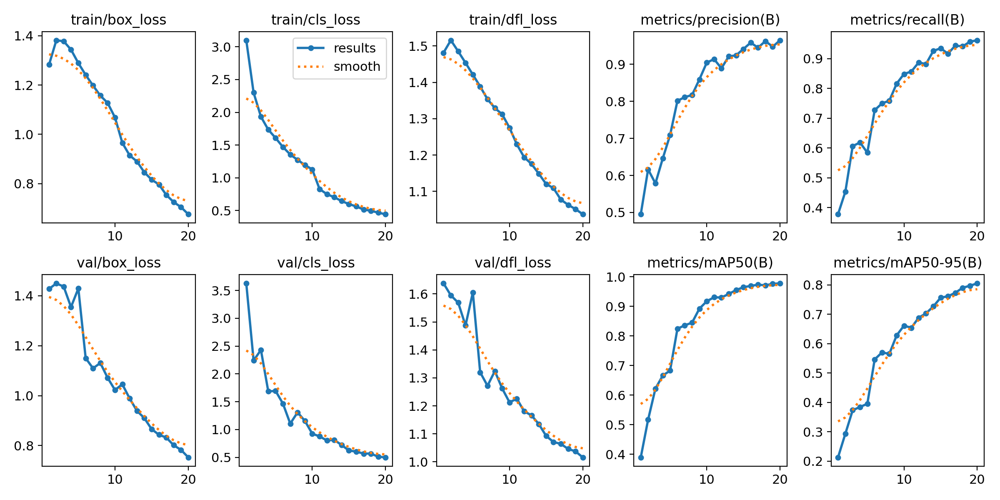

In [ ]:
from IPython.display import Image

# Display the training results
Image('runs/detect/train/results.png')

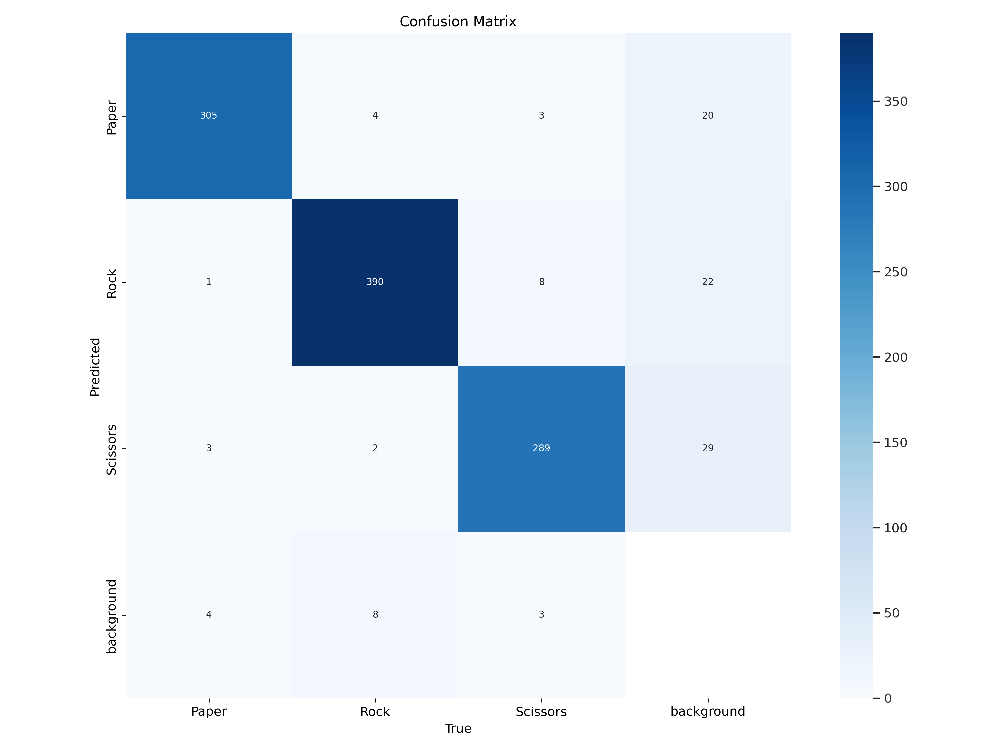

In [ ]:
# Display the confusion matrix
Image('runs/detect/train/confusion_matrix.png')

#Step 10: Process Video Files
Process video files using the trained YOLOv8 model and save the processed videos with bounding boxes and class labels.

**NOTE:** Ensure you have uploaded your video files to the testing folder before proceeding with this step.

In [43]:
import cv2

VIDEO_DIR = '/content/drive/MyDrive/roboflow_direct/video'

# Define the directory where you want to save the images
OUTPUT_DIR = '/content/drive/MyDrive/roboflow_direct/output'

# Create the output directory if it doesn't exist
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Path to the trained model file
model_file = "/content/drive/MyDrive/roboflow_direct/runs/detect/train/weights/best.pt"

# Load the trained model
model = YOLO(model_file)

# List all files in the folder
video_files = os.listdir(VIDEO_DIR)

# Process each video file
for video_file in video_files:
    cap = cv2.VideoCapture(os.path.join(VIDEO_DIR, video_file))

    # Get the dimensions and frame rate of the video
    w, h, fps = (int(cap.get(x)) for x in (cv2.CAP_PROP_FRAME_WIDTH, cv2.CAP_PROP_FRAME_HEIGHT, cv2.CAP_PROP_FPS))

    # Create the output video writer
    out = cv2.VideoWriter(f'{OUTPUT_DIR}/{video_file}_object_detection.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (w, h))

    ret, frame = cap.read()

    while ret:
        results = model(frame)[0]

        for result in results.boxes.data.tolist():
            x1, y1, x2, y2, score, class_id = result

            # Draw bounding box
            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)

            # Display class name and score
            label = f'{results.names[int(class_id)]}: {score:.2f}'
            cv2.putText(frame, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1, cv2.LINE_AA)

        out.write(frame)
        ret, frame = cap.read()

    cap.release()
    out.release()
    #cv2.destroyAllWindows()


0: 384x640 1 Rock, 12.1ms
Speed: 2.2ms preprocess, 12.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 11.5ms
Speed: 3.1ms preprocess, 11.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 8.3ms
Speed: 2.5ms preprocess, 8.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 9.1ms
Speed: 3.4ms preprocess, 9.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 8.6ms
Speed: 2.5ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 11.5ms
Speed: 3.5ms preprocess, 11.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 9.1ms
Speed: 3.1ms preprocess, 9.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock, 8.5ms
Speed: 2.5ms preprocess, 8.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Rock

#Step 11: Display Processed Video
Use the MoviePy library to display the processed video within the Colab environment.

In [44]:
from moviepy.editor import *

# Path to the processed video file
path = '/content/drive/MyDrive/roboflow_direct/output/250331_dyj.mp4_object_detection.mp4'

# Load the processed video clip
clip = VideoFileClip(path)

# Display the video clip
clip.ipython_display(height=540, width=960)

  if event.key is 'enter':



Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
!zip -r /content/drive/MyDrive/roboflow_direct_output.zip /content/drive/MyDrive/roboflow_direct/

  adding: content/drive/MyDrive/roboflow_direct/ (stored 0%)
  adding: content/drive/MyDrive/roboflow_direct/annotation/ (stored 0%)
  adding: content/drive/MyDrive/roboflow_direct/images/ (stored 0%)
  adding: content/drive/MyDrive/roboflow_direct/train/ (stored 0%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/ (stored 0%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/0001_png.rf.5e22fcd367ffc26ff60b1c51ad0f660c.jpg (deflated 2%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/0001_png.rf.b7e30e943e30c208a0a0bcf446e6cce4.jpg (deflated 2%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/0003_png.rf.c5f551008966064ae4c370591c971d83.jpg (deflated 2%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/0003_png.rf.d043c66e183b950e98b6d7ad83e1b246.jpg (deflated 1%)
  adding: content/drive/MyDrive/roboflow_direct/train/images/0005_png.rf.3cb60cd33cc6ed3af59f256523aa86a0.jpg (deflated 2%)
  adding: content/drive/MyDrive/robofl